# Modelo predictivo  (Espacial) de siniestros en las calles de Santiago
- UDD - MDS18 - BDA
- Final
- 60_Final_Geo_Project_EDA_Model_Result_Visualization
- 09 August 2019

**CHANGE KERNEL:** geo_p_3_7


GeoPandas v 0.4.1<br>
https://geopandas.readthedocs.io/en/v0.4.1/mapping.html

## Datasets (Landing)

###  CONASET
http://mapas-conaset.opendata.arcgis.com/search?groupIds=fca1f61c6556499db843c09cc80c70c0

Estas capas contienen la geocodificación de los accidentes de tránsito registrados en la Región Metropolitana entre los años 2013 y 2018. Contiene los detalles de fecha (en la mayoria solo día/mes), tipo de accidente, causa basal del accidente, dirección donde ocurrió el accidente, fallecidos y lesionados según gravedad. 
- [Siniestros RM - 2013](http://mapas-conaset.opendata.arcgis.com/datasets/12cb58c27a2846dfa60cf629a14d611a_0)
- [Siniestros RM - 2014](http://mapas-conaset.opendata.arcgis.com/datasets/aa5b5322bc564b809aa29c70658b9cf9_0)
- [Siniestros RM - 2015](http://mapas-conaset.opendata.arcgis.com/datasets/dafa26dbce99467985596d8a58216b79_0)
- [Siniestros RM - 2016](http://mapas-conaset.opendata.arcgis.com/datasets/32ee49c703b840b885b9c80b37ae72d0_0)
- [Siniestros RM - 2017](http://mapas-conaset.opendata.arcgis.com/datasets/907addac92b74e3fa30d40edb72d1813_0)
- [Siniestros RM - 2018](http://mapas-conaset.opendata.arcgis.com/datasets/3a084373b58b45d0ae01d9c14a231cf8_0)

### OpenStreetMap
- POI and streets of Santiago
<br><br>
http://download.geofabrik.de/south-america/chile.html

## Main Libraries and Initialization

In [2]:
from math import radians, cos, sin, asin, sqrt, atan2
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from pylab import rcParams
import seaborn as sns
import folium
import geopandas as gpd
from shapely.geometry import Point, Polygon
import warnings
warnings.filterwarnings('ignore')

[GeoPandas main functions Based on the work of Eduardo Graells-Garrido](https://github.com/carnby/carto-en-python/blob/master/01%20-%20GeoPandas.ipynb)

In [3]:
sns.set(context='paper', style='ticks', palette='inferno')
sns.mpl.rc("figure", figsize=(10, 6))
mpl.rcParams['figure.dpi']= 150

## Main Functions

In [4]:
def intersection(municipality, urban_area):
    return municipality.intersection(urban_area)

In [5]:
def urban_part(municipality):
    return intersection(municipality, stgo)

In [7]:
def plot_point_distribution(**kwargs):
    #print(kwargs)
    ax = plt.gca()
    
    # context!
    context.plot(ax=ax, alpha=0.7, color='grey')
    
    color = kwargs.pop('color')
    geodf = kwargs.pop('data')
    bounds = kwargs.pop('bounds', None)

    sns.kdeplot(geodf.geometry.x, geodf.geometry.y, **kwargs)

    if bounds is not None:
        plt.xlim(bounds[:,0])
        plt.ylim(bounds[:,1])
    
    plt.axis('equal')
    plt.axis('off')

In [8]:
def plot_heat_map(data, label, context):
    g = sns.FacetGrid(data=data, 
                      size=6, 
                      dropna=False
                     );

    g.map_dataframe(plot_point_distribution, 
                    shade=True, 
                    alpha=0.7, 
                    cbar=True, 
                    cmap='magma_r', 
                    cbar_kws={'orientation': 'horizontal',
                              'label': label,
                              'fraction': 0.02,
                              'shrink': 0.35,
                              'pad': 0}
                   );

In [65]:
def adding_din_feat_date_dist_to_grid(g, s, Feature, D1, D2, meters, agg_type='sum', ID='FID'): 
    s = s[(s.Ano >= D1) & (s.Ano <= D2)]
    s = s[['geometry', Feature]].copy()
    dist = (meters*0.1)/11000
    s['geometry']= s.geometry.buffer(dist)
    s = gpd.sjoin(g, s, how='left', op='intersects')
    s = s.fillna(0)
    Y = Feature+'_'+str(meters)
    s = s.rename(columns={'index_right': Y})
    s[Y] = s[Y].apply(lambda x: 0 if x == 0.0 else 1)
    gs = s.groupby(ID, as_index=False).agg({
        Y: agg_type,
        'geometry': 'first'
    })
    gs = gpd.GeoDataFrame(gs, crs='4326')
    print("Grid shape: ", gs.shape)
    print("Crash type {} has {} events".format(Y, round(gs[Y].sum())))
    return gs

## Import and visualize dataset 

In [10]:
ls ../data/CONASET/STGO_Crashes_2013_2018

Crashes_Stgo_2013_2018_dataset.cpg  Crashes_Stgo_2013_2018_dataset.shp
Crashes_Stgo_2013_2018_dataset.dbf  Crashes_Stgo_2013_2018_dataset.shx
Crashes_Stgo_2013_2018_dataset.prj


In [11]:
df = gpd.read_file("../data/CONASET/STGO_Crashes_2013_2018/Crashes_Stgo_2013_2018_dataset.shp", encoding='utf-8', crs={'init': 'epsg:5361'})
df.shape

(120042, 9)

In [12]:
df.head()

,Ano,Tipo__CONA,Fallecidos,Graves,Menos_Grav,Leves,SEV,SEV_Index,geometry
0,2013,ATROPELLO,0,0,0,1,L,2,POINT (-70.6264627040905 -33.43363955092453)
1,2013,CHOQUE,0,0,0,0,N,1,POINT (-70.6792097614213 -33.36821861599628)
2,2013,COLISION,0,0,0,0,N,1,POINT (-70.57352274937534 -33.5916636202798)
3,2013,OTRO TIPO,0,0,0,0,N,1,POINT (-70.66058176123926 -33.38905241753498)
4,2013,COLISION,0,0,0,0,N,1,POINT (-70.5893194571272 -33.4799039918757)


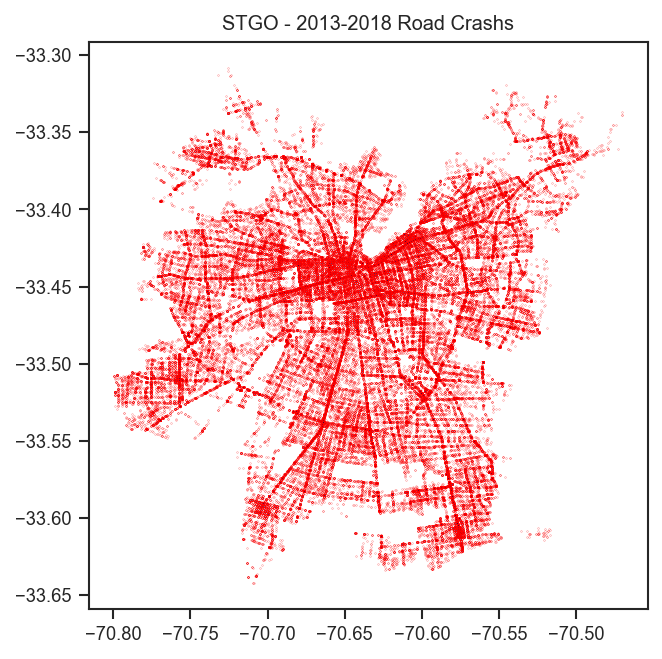

In [27]:
df.plot(markersize=0.01, edgecolor='red',figsize=(5, 5));
plt.title("STGO - 2013-2018 Road Crashs");

In [13]:
urban_areas = gpd.read_file('../data/OSM_Chile/urban_areas/',
                            crs={'init': 'epsg:5361'})

In [14]:
municipalities = gpd.read_file(
    '../data/OSM_Chile/shapefile_comunas/division_comunal.shp', crs={'init': 'epsg:5361'})

In [15]:
stgo_municipalities = gpd.sjoin(municipalities, urban_areas[urban_areas.NOMBRE == 'Santiago'], 
                                op='intersects')
stgo_municipalities.shape

(36, 15)

In [16]:
stgo = urban_areas[urban_areas.NOMBRE == 'Santiago'].geometry.values[0]

In [17]:
stgo_shape = urban_areas[urban_areas.NOMBRE == 'Santiago'].to_crs({'init': 'epsg:4326'})

In [18]:
stgo_shape.total_bounds

array([-70.79976813, -33.65120143, -70.46601154, -33.29815073])

In [19]:
stgo_urban_municipalities = (stgo_municipalities.copy()
                             .assign(geometry=lambda df_: df_['geometry'].map(urban_part))
                             .pipe(lambda x: x[~x.NOM_COM.isin(['Lampa', 'Colina'])])
                             .to_crs({'init': 'epsg:4326'}))
stgo_urban_municipalities.shape

(34, 15)

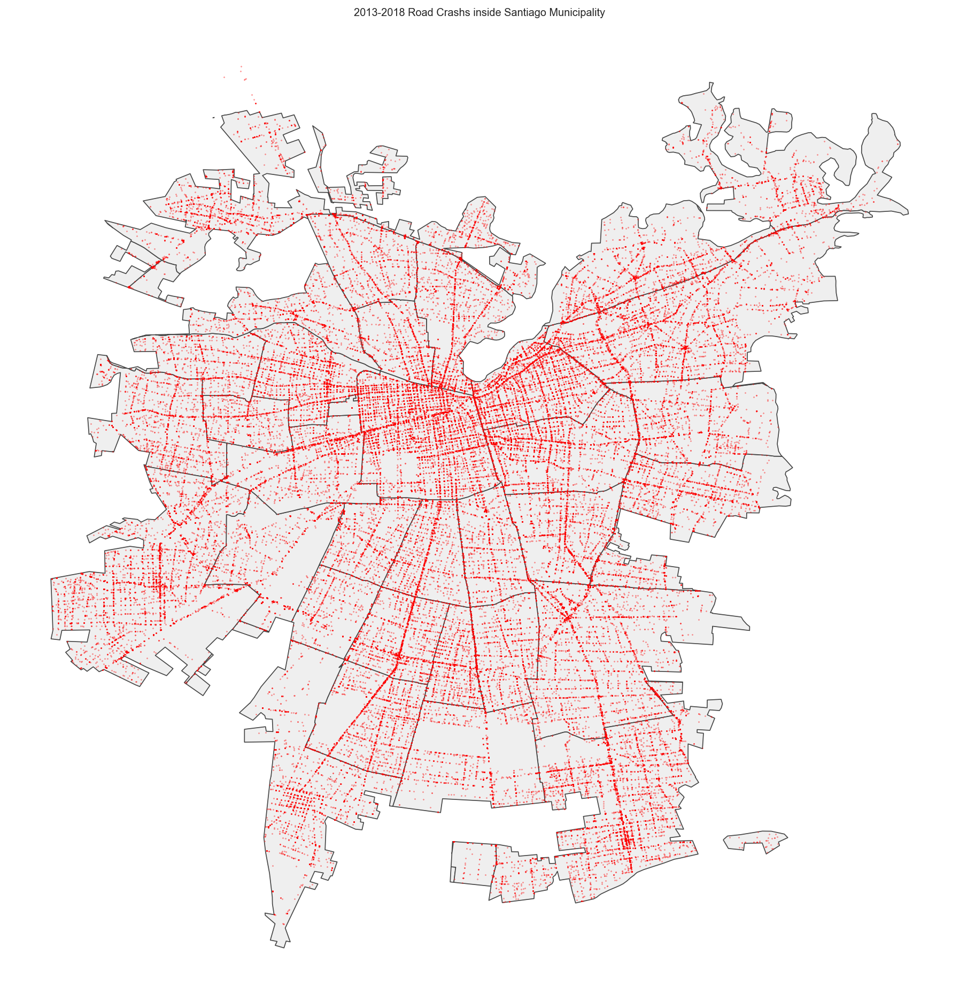

In [28]:
ax = stgo_urban_municipalities.plot(figsize=(18,16), color='#EFEFEF', edgecolor='#444444')
df.plot(ax=ax, marker='o', color='red', markersize=0.05);
plt.title("2013-2018 Road Crashs inside Santiago Municipality");
ax.set_axis_off()

In [20]:
df_2018 = df[df.Ano == 2018]

In [21]:
df_2017 = df[df.Ano == 2017]

In [22]:
df_2016 = df[df.Ano == 2016]

In [23]:
df_2015 = df[df.Ano == 2015]

In [24]:
df_2014 = df[df.Ano == 2014]

In [25]:
df_2013 = df[df.Ano == 2013]

In [26]:
df_2013_2017 = df[df.Ano != 2018]

In [48]:
context = stgo_urban_municipalities.to_crs({'init': 'epsg:4326'})

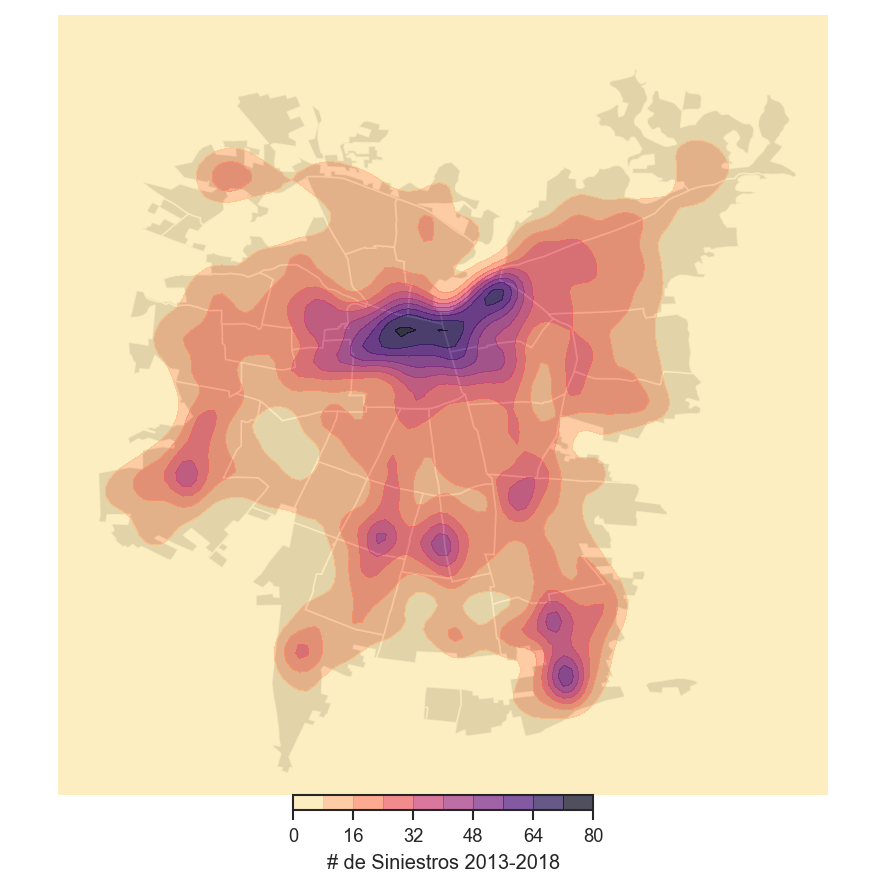

In [68]:
plot_heat_map(df, '# de Siniestros 2013-2018', context)

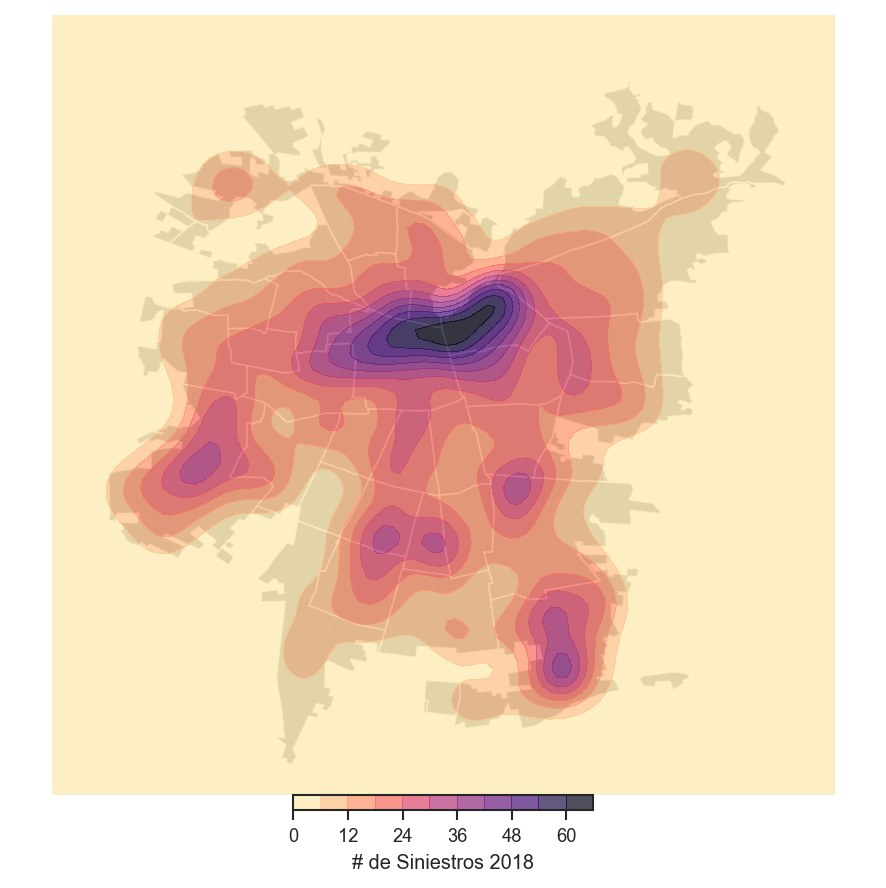

In [65]:
plot_heat_map(df_2018, '# de Siniestros 2018', context)

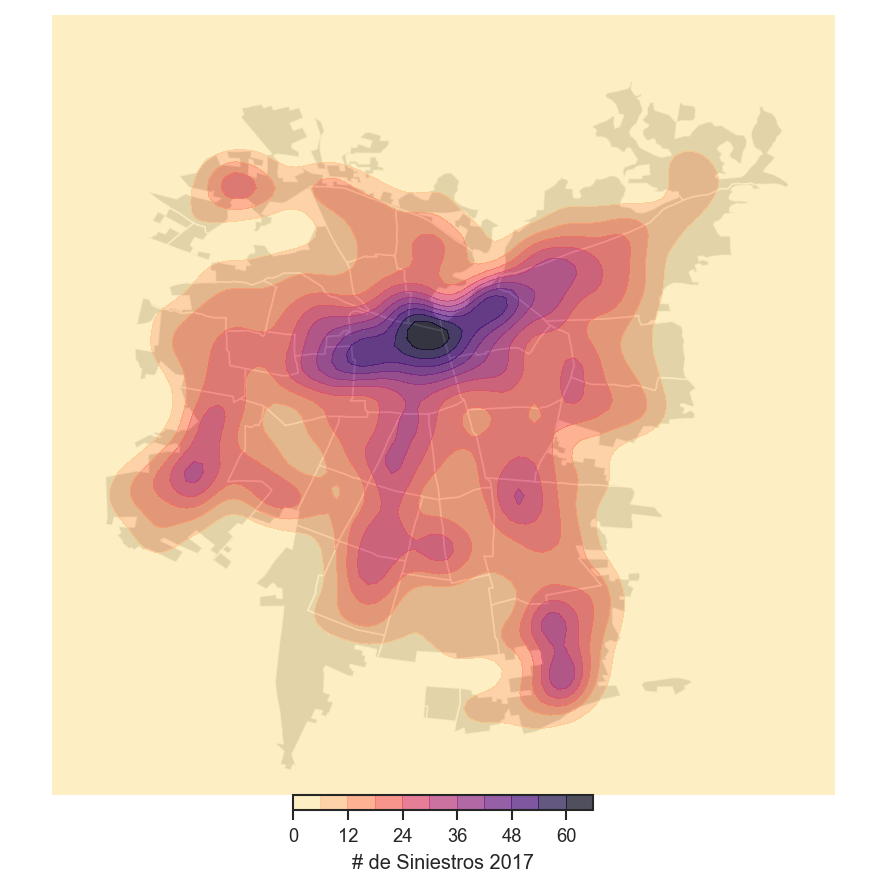

In [58]:
plot_heat_map(df_2017, '# de Siniestros 2017', context)

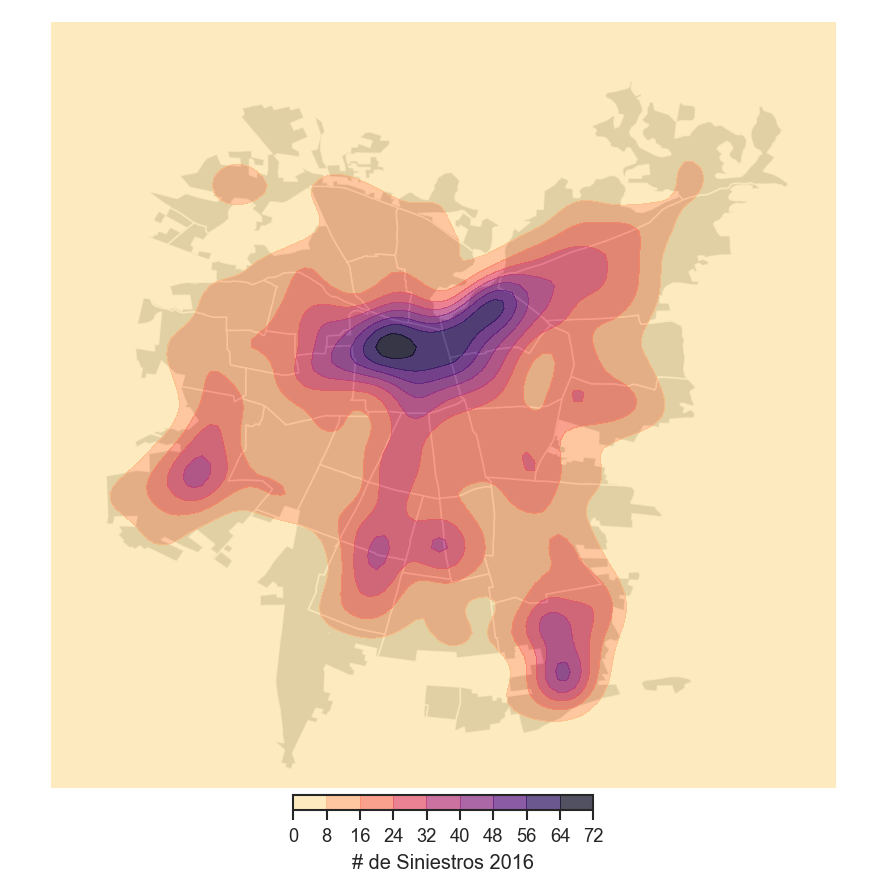

In [59]:
plot_heat_map(df_2016, '# de Siniestros 2016', context)

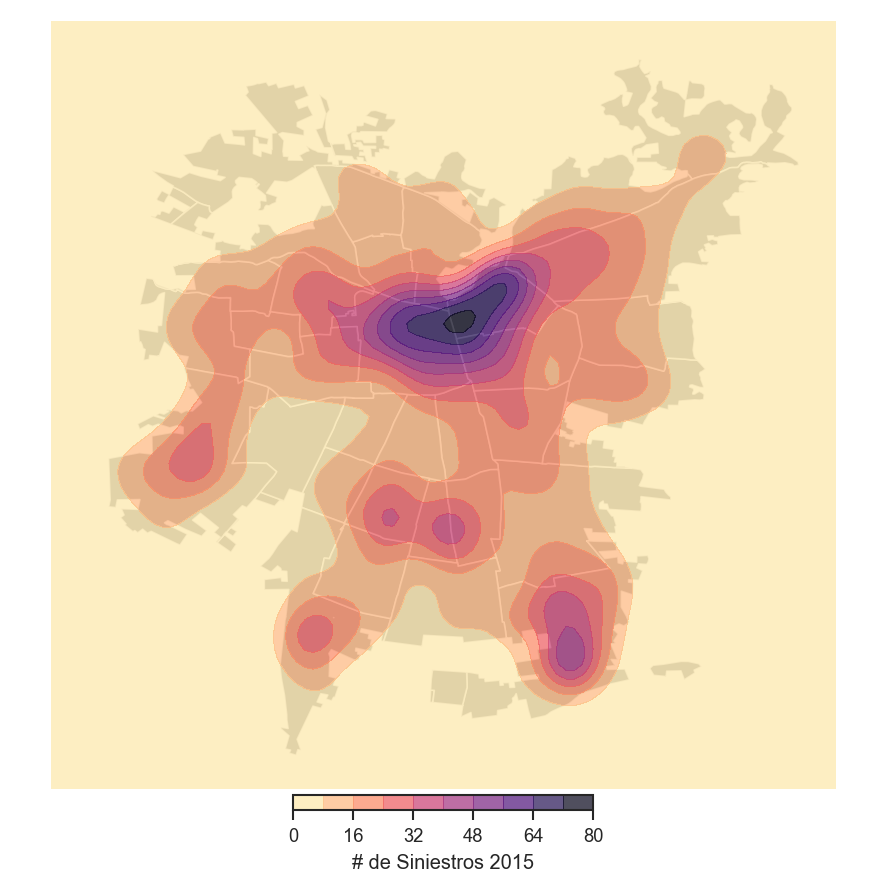

In [60]:
plot_heat_map(df_2015, '# de Siniestros 2015', context)

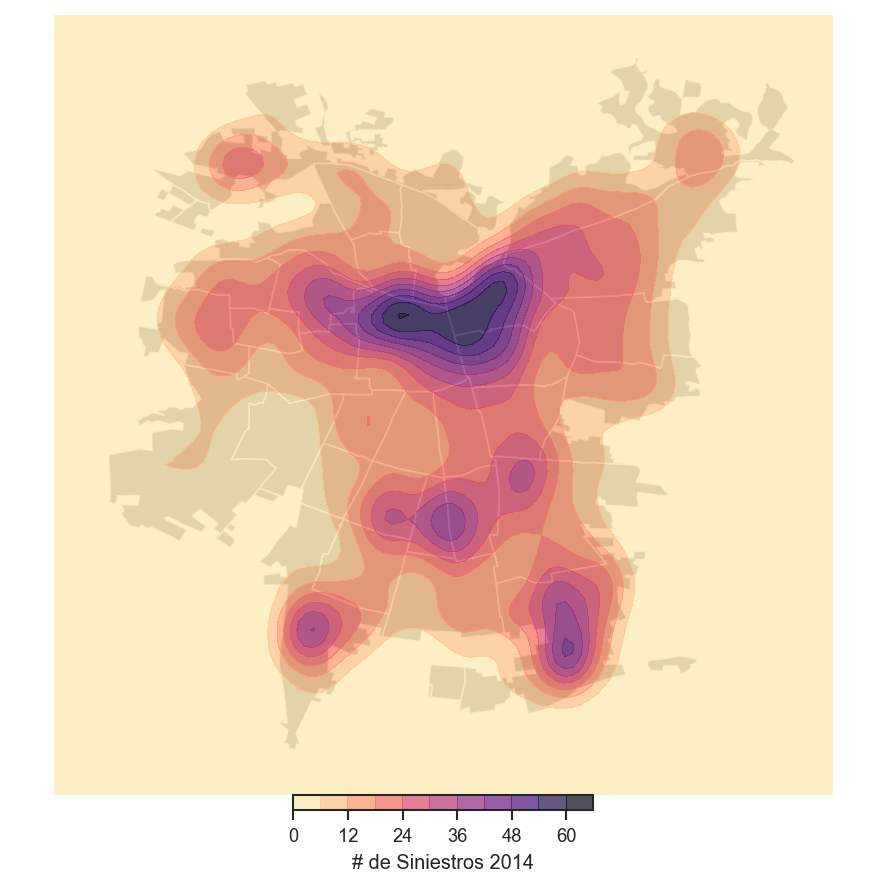

In [61]:
plot_heat_map(df_2014, '# de Siniestros 2014', context)

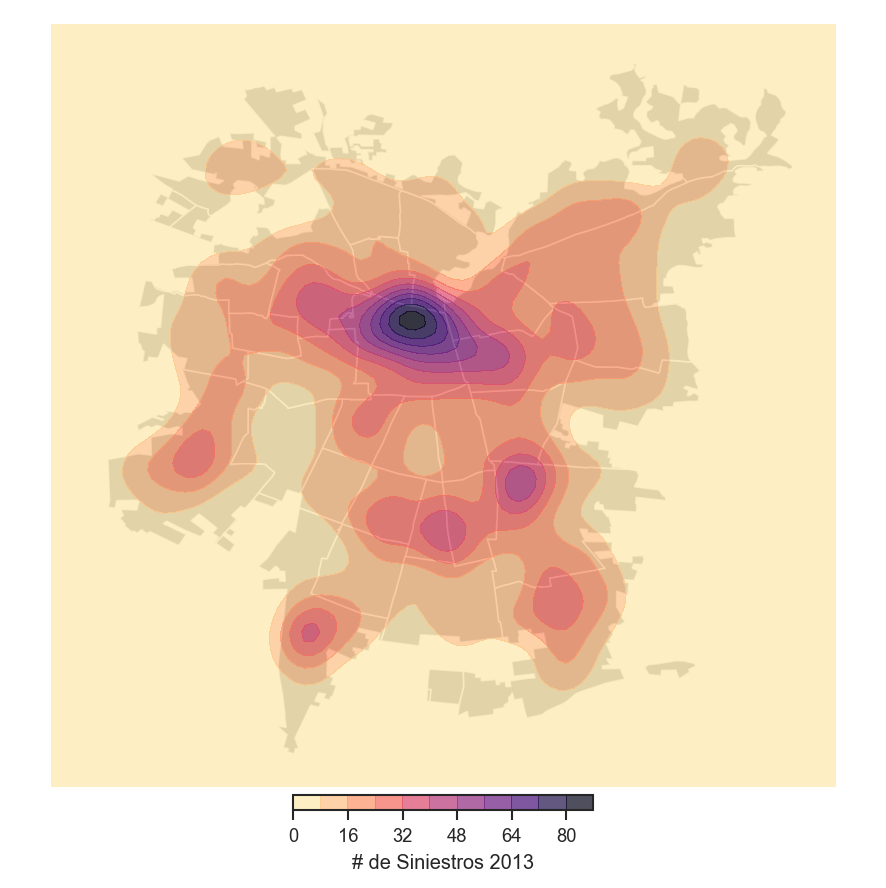

In [62]:
plot_heat_map(df_2013, '# de Siniestros 2013', context)

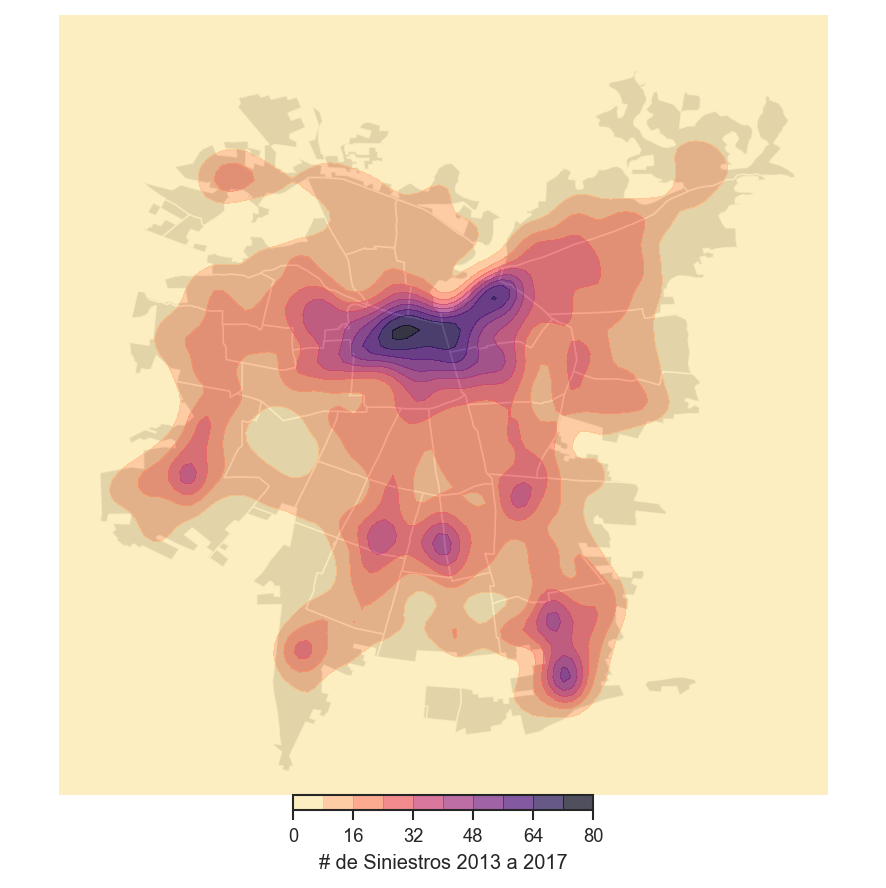

In [66]:
plot_heat_map(df_2013_2017, '# de Siniestros 2013 a 2017', context)

## Model Result Spatial Visualization 

In [28]:
cp_2018 = pd.read_csv("../model/Visualization_Crash_Prevision_2018.csv")
cp_2018.shape

(63029, 7)

In [29]:
del cp_2018['Unnamed: 0']
cp_2018.head(2)

,id,X,Y,label,probability,prediction
0,0,-70.824738,-33.557697,0.0,0.956,0.0
1,1,-70.823831,-33.556787,0.0,0.956,0.0


In [30]:
cp_2018['geometry'] = cp_2018.apply(lambda row: Point(row.X, row.Y), axis=1)

In [31]:
cp_2018 = gpd.GeoDataFrame(cp_2018)

In [32]:
cp_2018.head(2)

,id,X,Y,label,probability,prediction,geometry
0,0,-70.824738,-33.557697,0.0,0.956,0.0,POINT (-70.82473789666899 -33.55769657833471)
1,1,-70.823831,-33.556787,0.0,0.956,0.0,POINT (-70.82383071364943 -33.5567874368874)


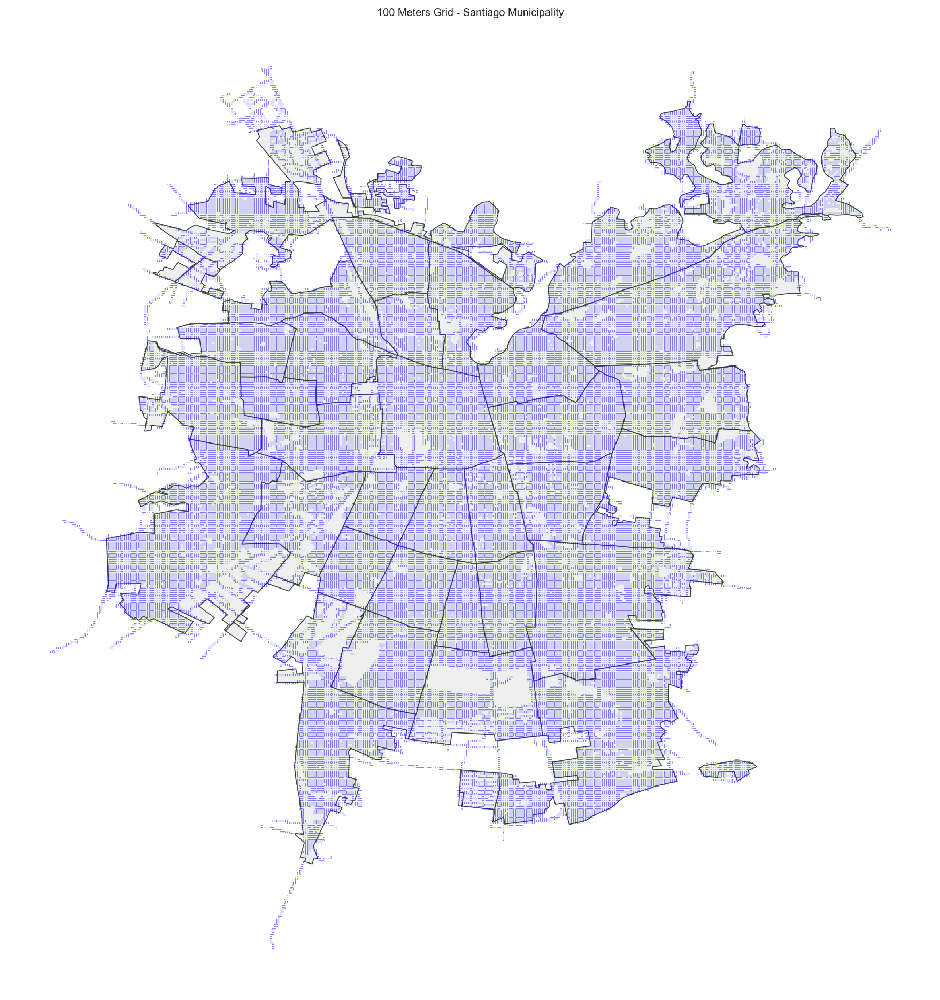

In [90]:
ax = stgo_urban_municipalities.plot(figsize=(18,16), color='#EFEFEF', edgecolor='#444444')
cp_2018.plot(ax=ax, marker='o', color='blue', markersize=0.05);
plt.title("100 Meters Grid - Santiago Municipality");
ax.set_axis_off()

In [33]:
real_Crashs_2018 = cp_2018[cp_2018.label == 1]

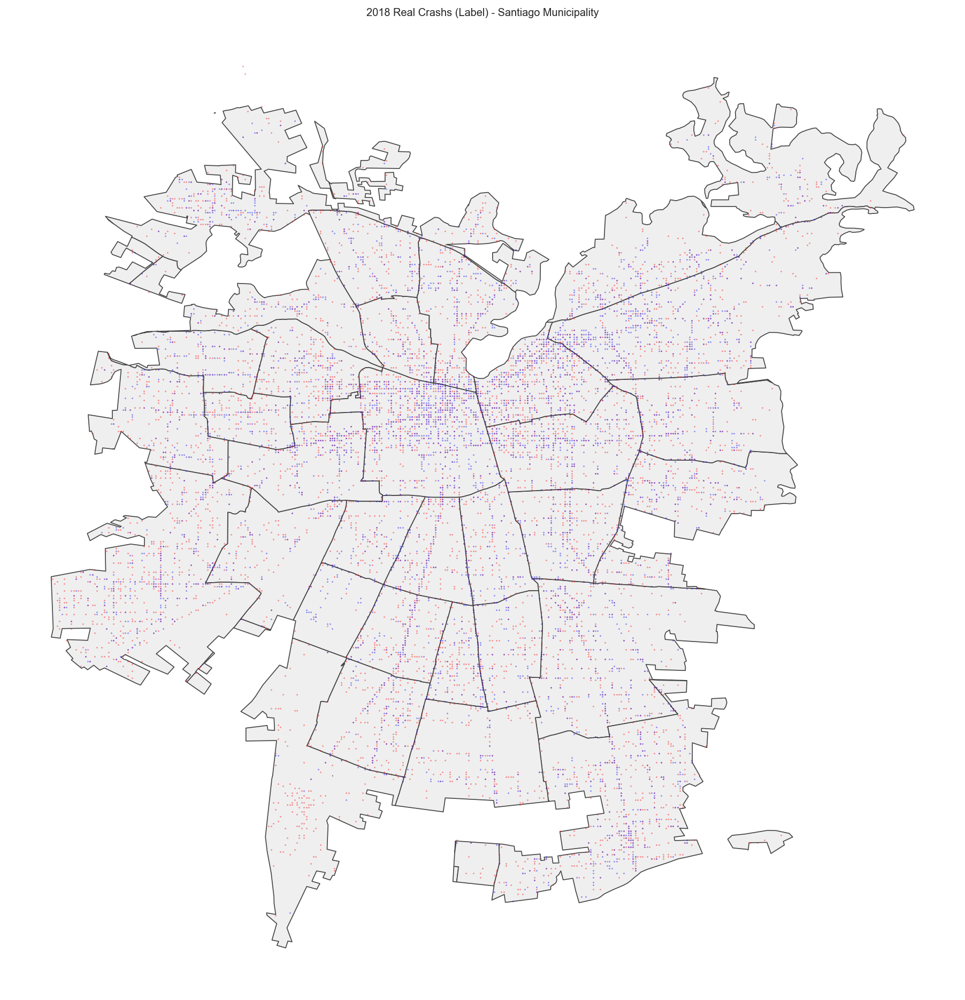

In [97]:
ax = stgo_urban_municipalities.plot(figsize=(18,16), color='#EFEFEF', edgecolor='#444444')
real_Crashs_2018.plot(ax=ax, marker='o', color='red', markersize=0.05);
pred_Crashs_2018.plot(ax=ax, marker='o', color='blue', markersize=0.05);
plt.title("2018 Real Crashs (Label) - Santiago Municipality");
ax.set_axis_off()

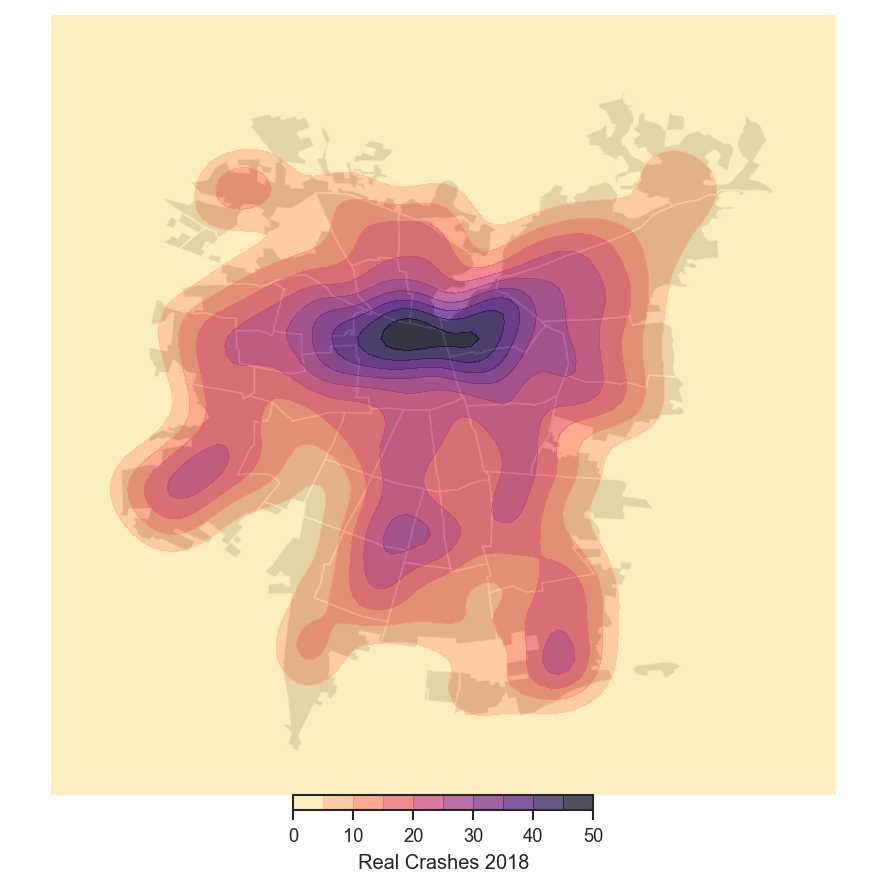

In [104]:
plot_heat_map(real_Crashs_2018, 'Real Crashes 2018', context)

In [34]:
pred_Crashs_2018 = cp_2018[cp_2018.prediction == 1]

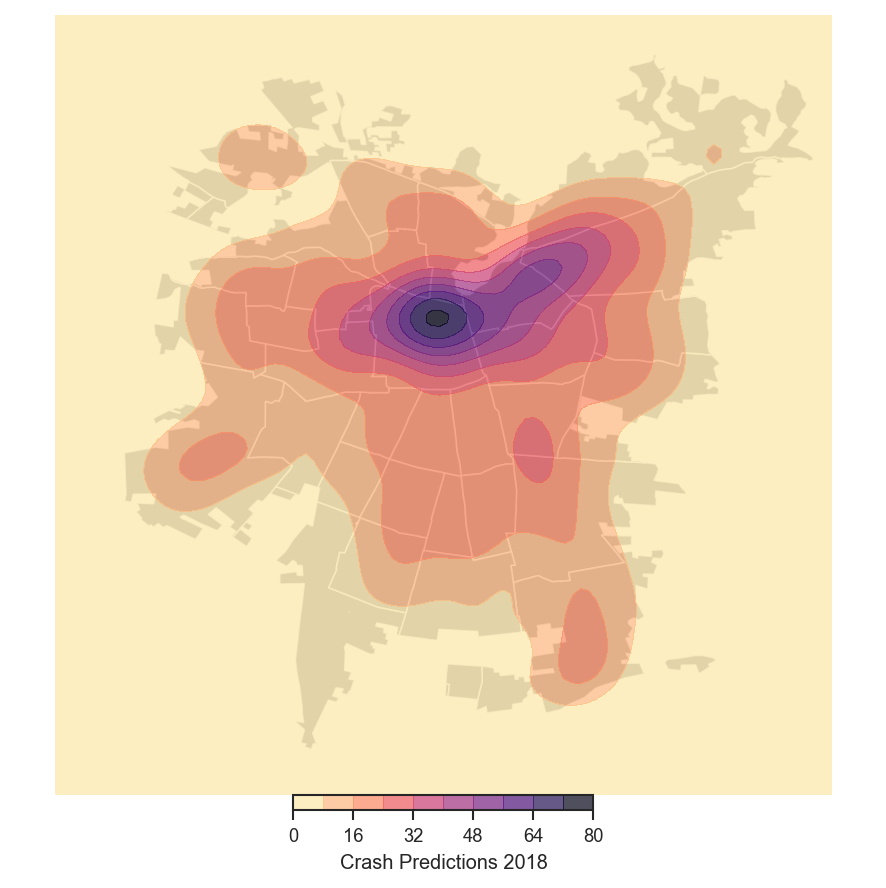

In [111]:
plot_heat_map(pred_Crashs_2018, 'Crash Predictions 2018', context)

In [35]:
pred_Crashs_2018_TP = cp_2018[(cp_2018.prediction == 1) & (cp_2018.label == 1)]

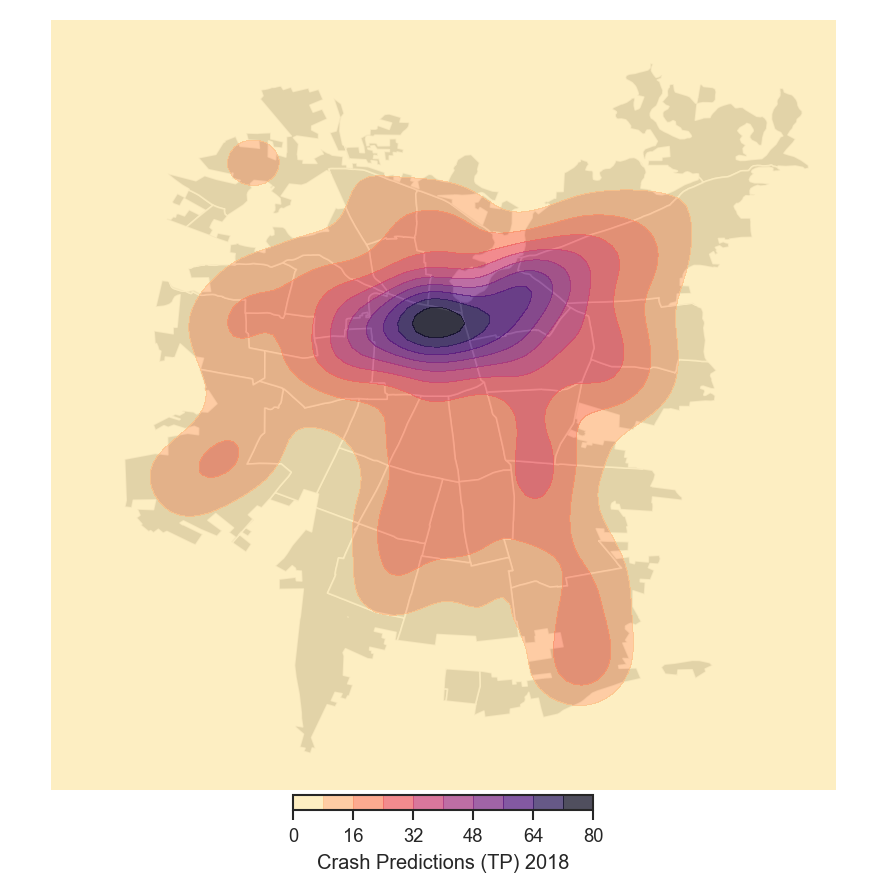

In [116]:
plot_heat_map(pred_Crashs_2018_TP, 'Crash Predictions (TP) 2018', context)

In [36]:
pred_Crashs_2018_FP = cp_2018[(cp_2018.prediction == 1) & (cp_2018.label == 0)]

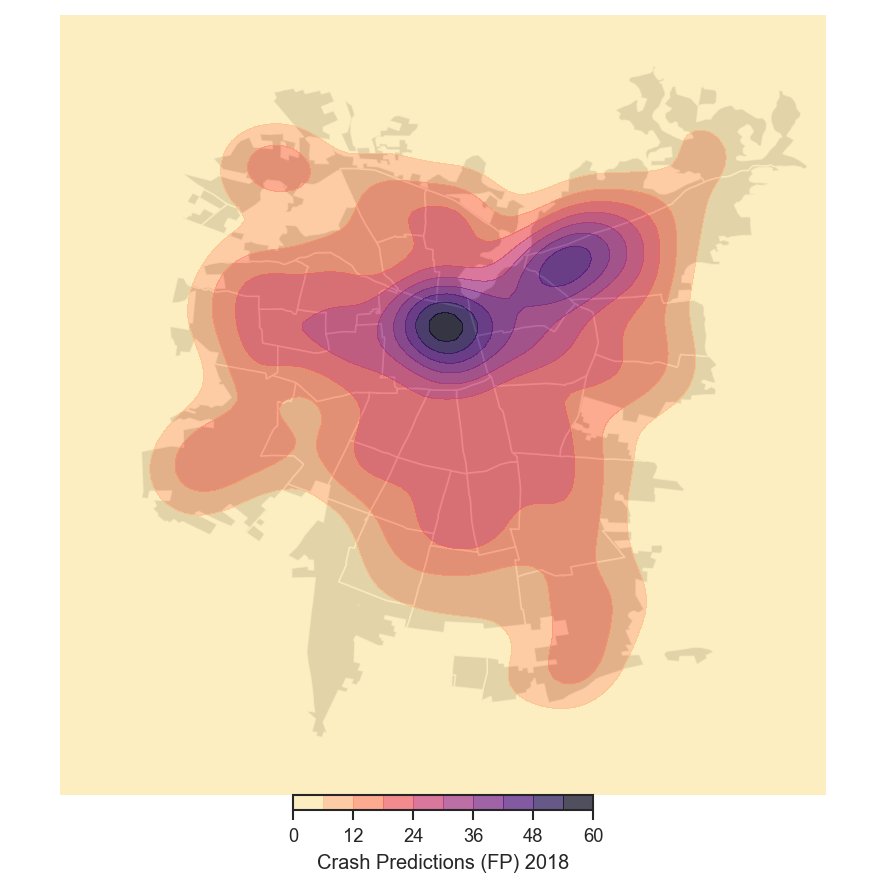

In [114]:
plot_heat_map(pred_Crashs_2018_FP, 'Crash Predictions (FP) 2018', context)

In [37]:
pred_Crashs_2018_FN = cp_2018[(cp_2018.prediction == 0) & (cp_2018.label == 1)]

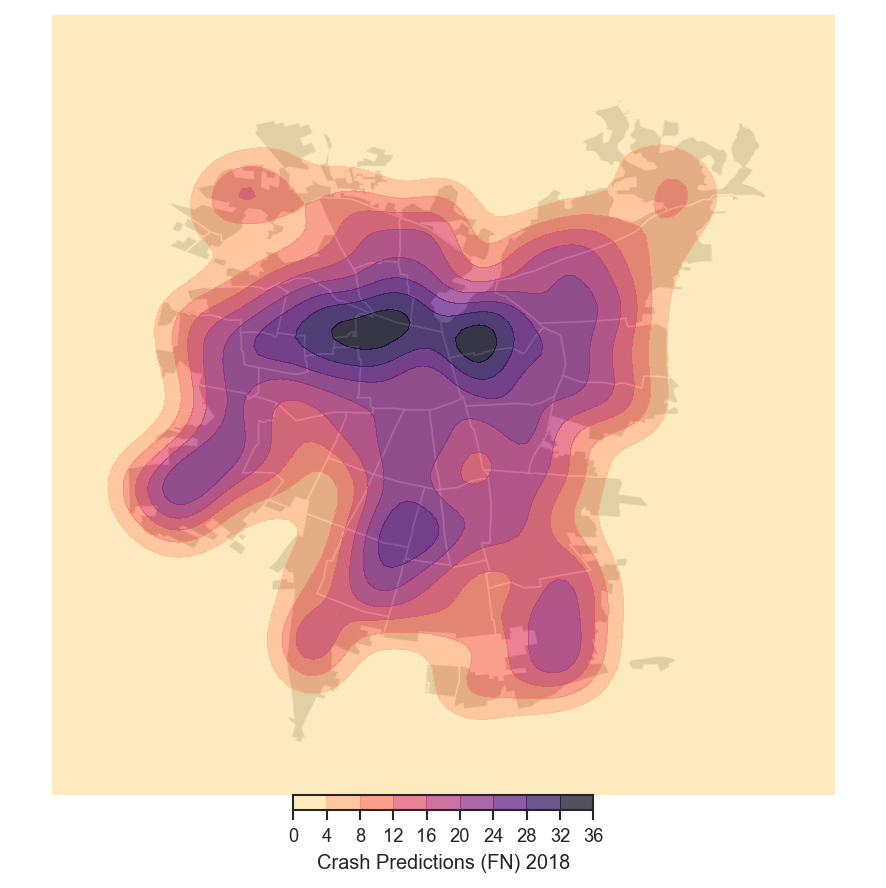

In [119]:
plot_heat_map(pred_Crashs_2018_FN, 'Crash Predictions (FN) 2018', context)

In [38]:
pred_Crashs_2018_TN = cp_2018[(cp_2018.prediction == 0) & (cp_2018.label == 0)]

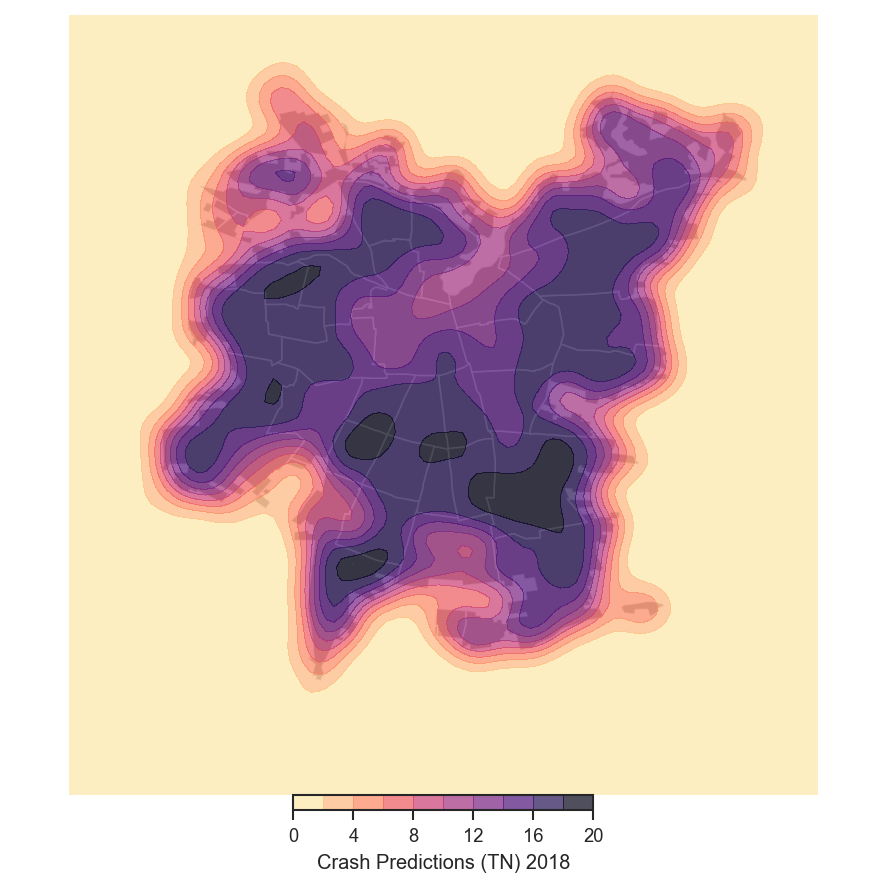

In [121]:
plot_heat_map(pred_Crashs_2018_TN, 'Crash Predictions (TN) 2018', context)

## Test Results on Santiago County

In [130]:
santiago_comuna = stgo_urban_municipalities[stgo_urban_municipalities.NOM_COM == 'Santiago']

In [131]:
santiago_comuna.head(2)

,NOM_REG,NOM_PROV,NOM_COM,SHAPE_LENG,DIS_ELEC,CIR_SENA,COD_COMUNA,SHAPE_Le_1,SHAPE_Area_left,geometry,index_right,NOMBRE,TIPO_AREA,SHAPE_Leng,SHAPE_Area_right
305,Región Metropolitana de Santiago,Santiago,Santiago,24644.018619,22,7,1310,22142.660056,2.276999e+07,POLYGON ((-70.67158854755513 -33.4763598849684...,385,Santiago,Ciudad,427491.444262,5.821041e+08


In [132]:
del santiago_comuna['index_right']
del santiago_comuna['NOMBRE']
del santiago_comuna['TIPO_AREA']
del santiago_comuna['SHAPE_Leng']
del santiago_comuna['SHAPE_Area_right']

In [133]:
santiago_comuna.total_bounds

array([-70.69184798, -33.47695736, -70.62457883, -33.42679503])

In [134]:
santiago_comuna.centroid

305    POINT (-70.65641338735799 -33.4535395845603)
dtype: object

In [125]:
grid_path = "../data/OSM_Chile/grid/stgo_grid_to_roads_100m.shp"
grid = gpd.read_file(grid_path, encoding='utf-8', crs={'init': 'epsg:4326'})
grid.shape

(63029, 2)

In [135]:
grid_com_stgo = gpd.sjoin(grid, santiago_comuna, op='intersects')
grid_com_stgo.crs = {'init' :'epsg:4326'}

In [157]:
m = folium.Map(location=[-33.4535395845603, -70.65641338735799],
               tiles="cartodbpositron",
               zoom_start=16)
for i, row in df_2018.iterrows():
    folium.CircleMarker(
        [row['geometry'].y, row['geometry'].x],
        radius=5,
        color='red',
    ).add_to(m)

for i, row in pred_Crashs_2018_TP.iterrows():
    folium.CircleMarker([row['geometry'].y, row['geometry'].x],
                        radius=10,
                        color='green',
                        fill=True).add_to(m)

m.choropleth(geo_data=grid_com_stgo,
             line_color='blue',
             line_weight=0.25,
             color='blue',
             fill_opacity=0.025)
m

---

## Working with "Sensal Zones"

In [6]:
zones = (gpd.read_file('../data/OSM_Chile/2012_eod_stgo/Zonificacion_EOD2012/', crs={'init': 'epsg:5361'}).set_index('ID'))
zones.head()

,AREA,Zona,Com,Comuna,geometry
ID,,,,,
103,837.7500,103.0,13105,El Bosque,"POLYGON ((346376.6925730131 6286027.028697187,..."
104,998.8125,104.0,13105,El Bosque,"POLYGON ((344151.2352592435 6285465.039511388,..."
106,286.2500,106.0,13105,El Bosque,"POLYGON ((344415.4339754293 6285878.048256716,..."
115,857.4375,115.0,13105,El Bosque,"POLYGON ((344415.4339754293 6285878.048256716,..."
116,853.9375,116.0,13105,El Bosque,"POLYGON ((345133.4208225487 6286261.982521651,..."


In [39]:
urban_zones = (zones.copy()
               .assign(geometry=lambda df_: df_.geometry.buffer(0).map(urban_part))
               .pipe(lambda df_: df_[~df_.is_empty].copy())
               .to_crs({'init': 'epsg:4326'}))
urban_zones.shape

(743, 5)

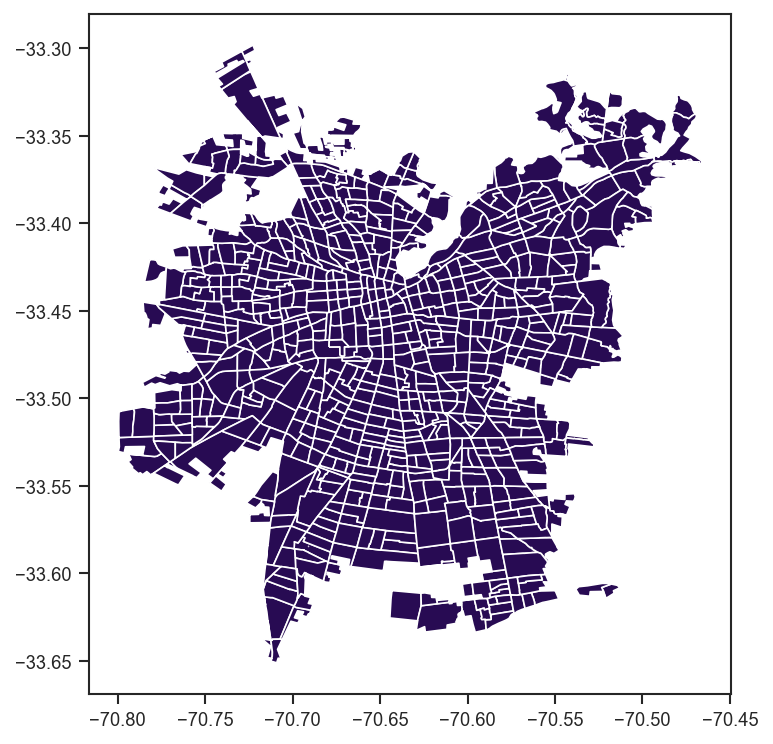

In [41]:
urban_zones.plot(edgecolor='white')

In [44]:
zone_centroids = urban_zones.centroid

In [45]:
zone_centroids.sample(5)

ID
642    POINT (-70.65560932201545 -33.48842509726872)
535    POINT (-70.74482322029154 -33.45935613425323)
235    POINT (-70.62313979936476 -33.51926224531401)
186    POINT (-70.67042914717651 -33.51971595651323)
568    POINT (-70.70869641982368 -33.43475591731715)
dtype: object

In [50]:
context = urban_zones.to_crs({'init': 'epsg:4326'})

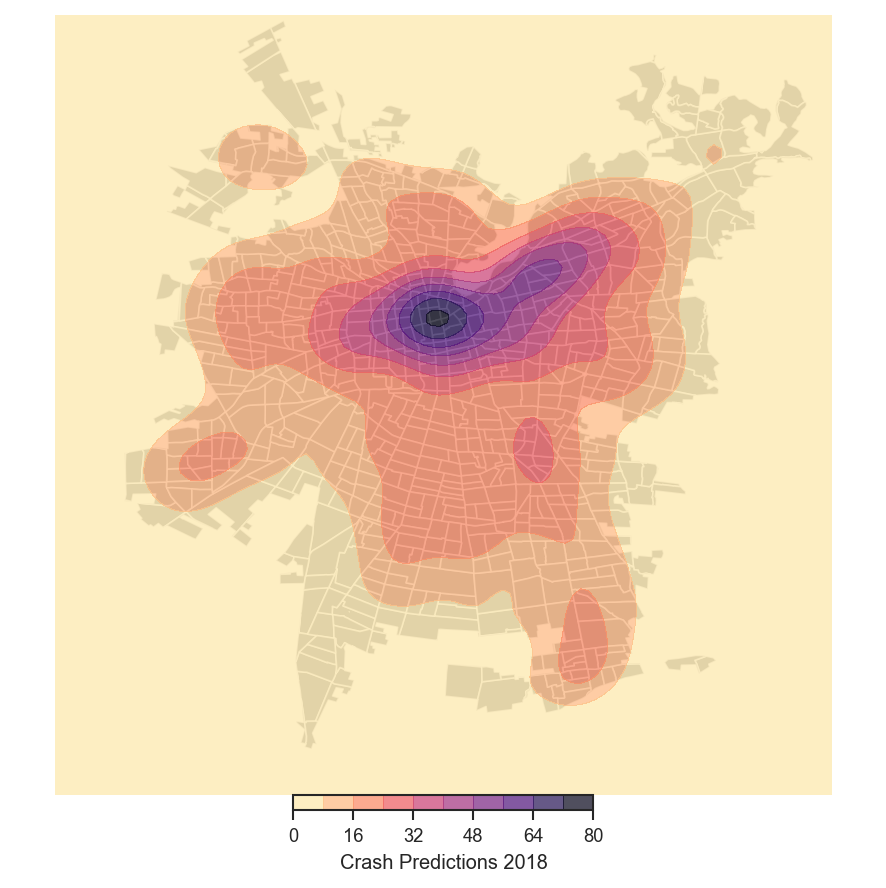

In [52]:
plot_heat_map(pred_Crashs_2018, 'Crash Predictions 2018', context)

### Create a map with Crashes and zones

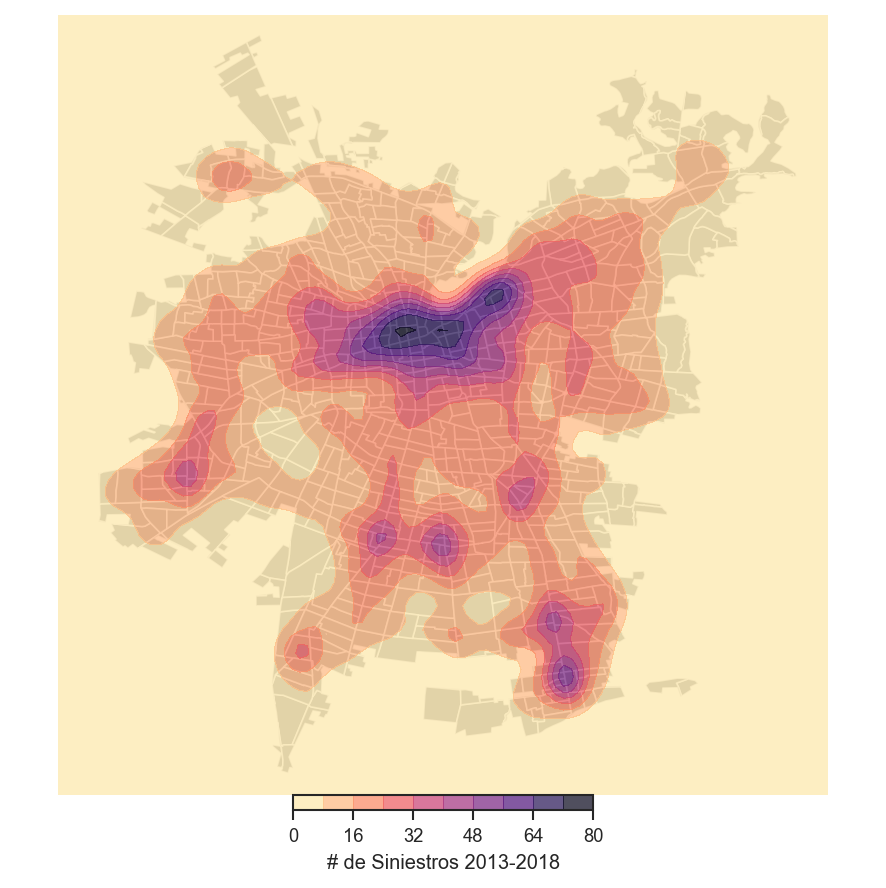

In [84]:
plot_heat_map(df, '# de Siniestros 2013-2018', context)

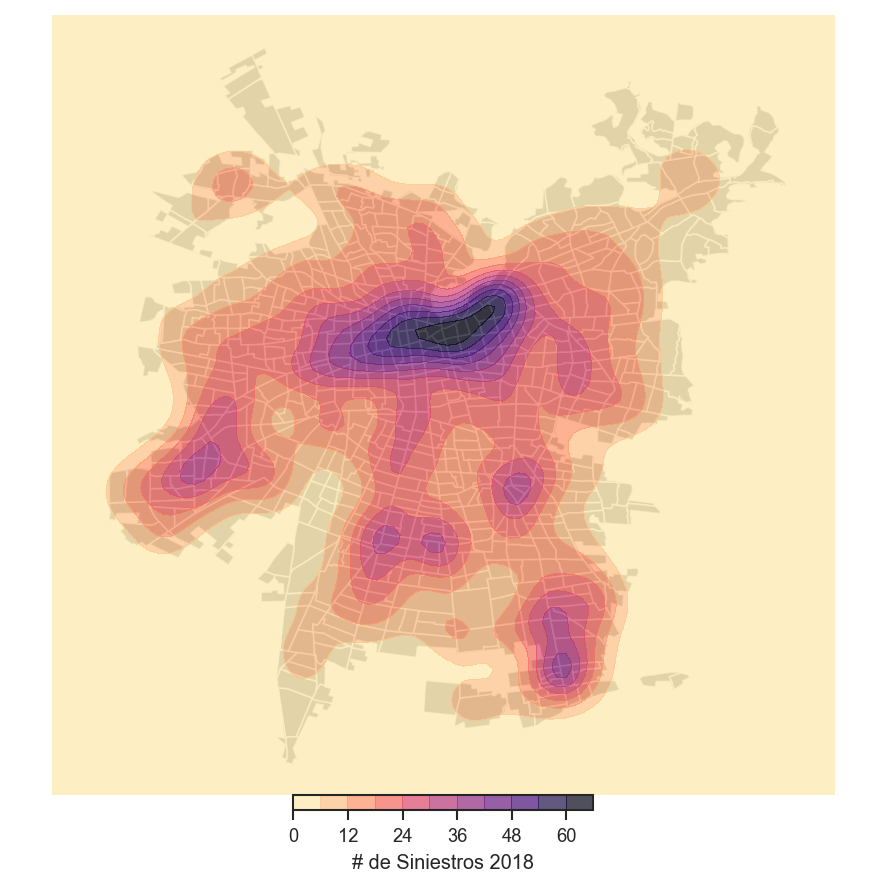

In [53]:
plot_heat_map(df_2018, '# de Siniestros 2018', context)

In [57]:
df_2018['Sin'] = 1
df_2018.head(2)

,Ano,Tipo__CONA,Fallecidos,Graves,Menos_Grav,Leves,SEV,SEV_Index,geometry,Sin
100766,2018,ATROPELLO,0,0,0,1,L,2,POINT (-70.693825 -33.390476),1
100767,2018,COLISION,0,0,0,0,N,1,POINT (-70.782501 -33.529778),1


In [64]:
df_2018.Sin.sum()

19276

In [66]:
 crash_zone_2018 = adding_din_feat_date_dist_to_grid(context, df_2018, 'Sin', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type Sin_1 has 20584 events


In [68]:
crash_zone_2018.head(2)

,Zona,Sin_1,geometry
0,1.0,22,POLYGON ((-70.66922200000185 -33.4321380000007...
1,2.0,57,POLYGON ((-70.67486000000189 -33.4334140000007...


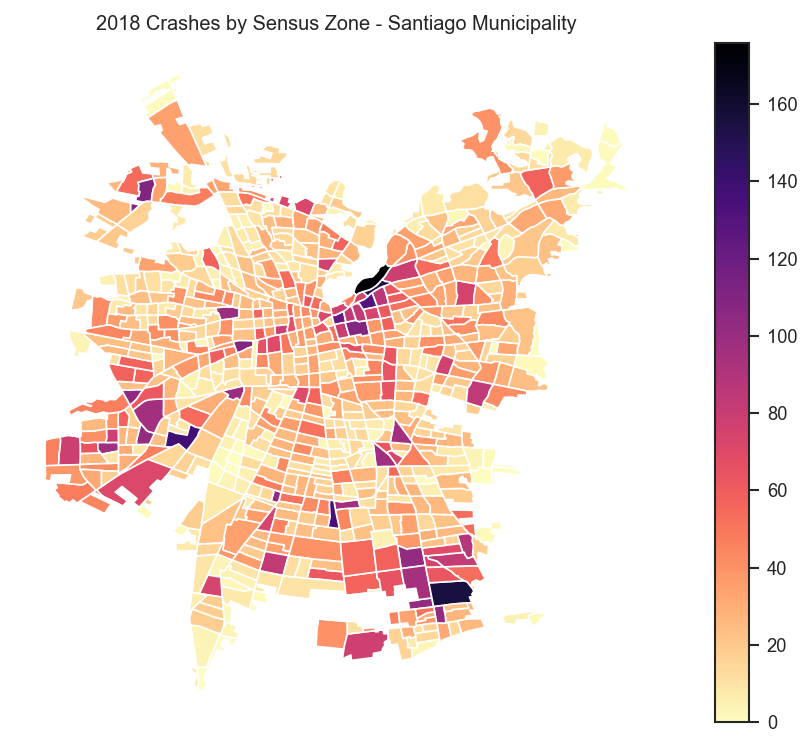

In [78]:
ax = crash_zone_2018.plot(column='Sin_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 Crashes by Sensus Zone - Santiago Municipality");
ax.set_axis_off()

In [79]:
df['Sin'] = 1
df.head()

,Ano,Tipo__CONA,Fallecidos,Graves,Menos_Grav,Leves,SEV,SEV_Index,geometry,Sin
0,2013,ATROPELLO,0,0,0,1,L,2,POINT (-70.6264627040905 -33.43363955092453),1
1,2013,CHOQUE,0,0,0,0,N,1,POINT (-70.6792097614213 -33.36821861599628),1
2,2013,COLISION,0,0,0,0,N,1,POINT (-70.57352274937534 -33.5916636202798),1
3,2013,OTRO TIPO,0,0,0,0,N,1,POINT (-70.66058176123926 -33.38905241753498),1
4,2013,COLISION,0,0,0,0,N,1,POINT (-70.5893194571272 -33.4799039918757),1


In [82]:
crash_zone_2013_2018 = adding_din_feat_date_dist_to_grid(context, df, 'Sin', 2013, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type Sin_1 has 134088 events


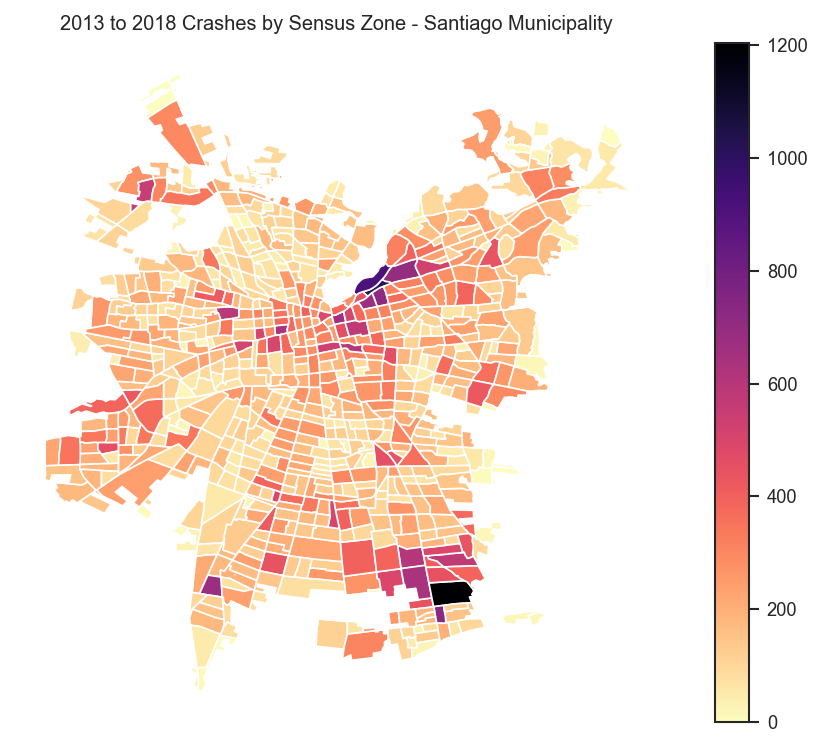

In [83]:
ax = crash_zone_2013_2018.plot(column='Sin_1', cmap='magma_r', k=5, legend=True)
plt.title("2013 to 2018 Crashes by Sensus Zone - Santiago Municipality");
ax.set_axis_off()

In [89]:
pred_Crashs_2018_TP['Ano'] = 2018

In [90]:
pred_Crashs_2018_TP.head(2)

,id,X,Y,label,probability,prediction,geometry,Ano
277,277,-70.794740,-33.519515,1.0,0.378,1.0,POINT (-70.79473980455856 -33.5195147096147),2018
390,390,-70.792013,-33.524969,1.0,0.247,1.0,POINT (-70.79201253183129 -33.52496925506924),2018


In [100]:
crash_zone_Pred_TP_2018 = adding_din_feat_date_dist_to_grid(context, pred_Crashs_2018_TP, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 2289 events


In [101]:
crash_zone_Pred_TP_2018.head(2)

,Zona,prediction_1,geometry
0,1.0,4,POLYGON ((-70.66922200000185 -33.4321380000007...
1,2.0,7,POLYGON ((-70.67486000000189 -33.4334140000007...


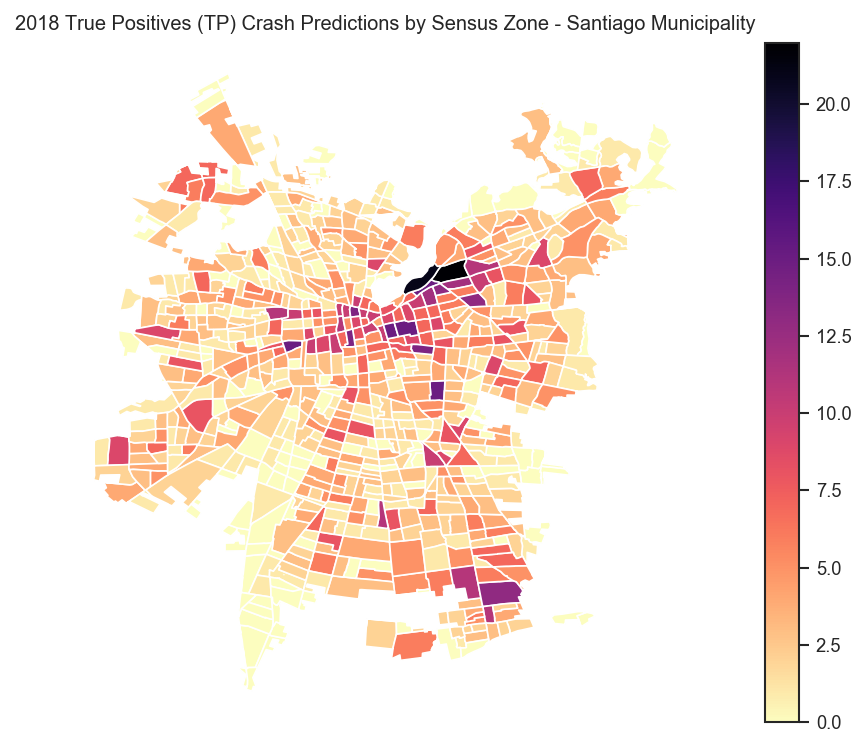

In [102]:
ax = crash_zone_Pred_TP_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 True Positives (TP) Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off()

In [107]:
pred_Crashs_2018_FP['Ano'] = 2018
crash_zone_Pred_FP_2018 = adding_din_feat_date_dist_to_grid(context, pred_Crashs_2018_FP, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 2228 events


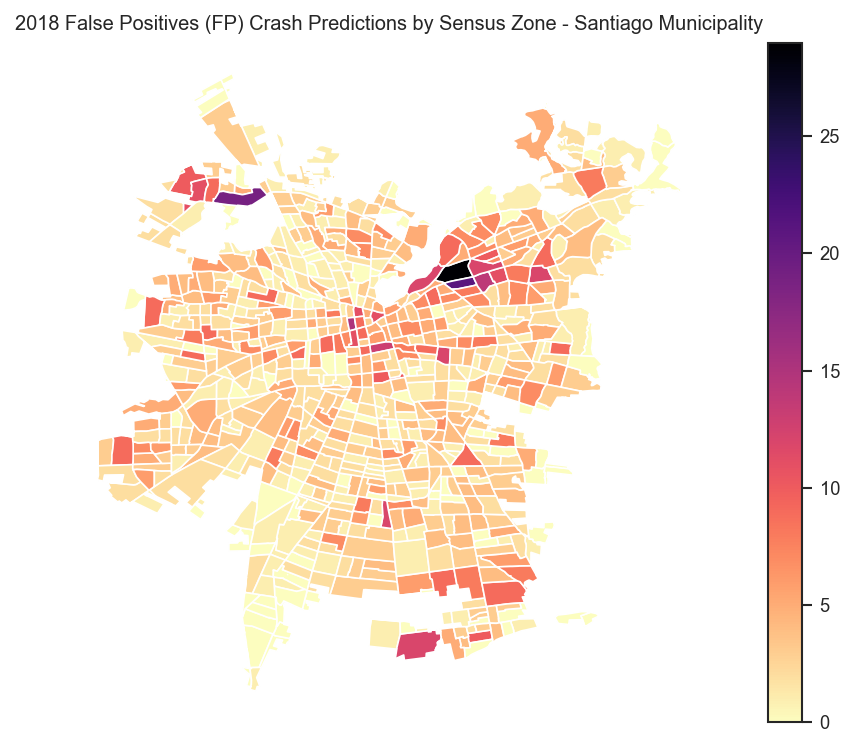

In [108]:
ax = crash_zone_Pred_FP_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 False Positives (FP) Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

In [105]:
pred_Crashs_2018_FN['Ano'] = 2018
crash_zone_Pred_FN_2018 = adding_din_feat_date_dist_to_grid(context, pred_Crashs_2018_FN, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 4461 events


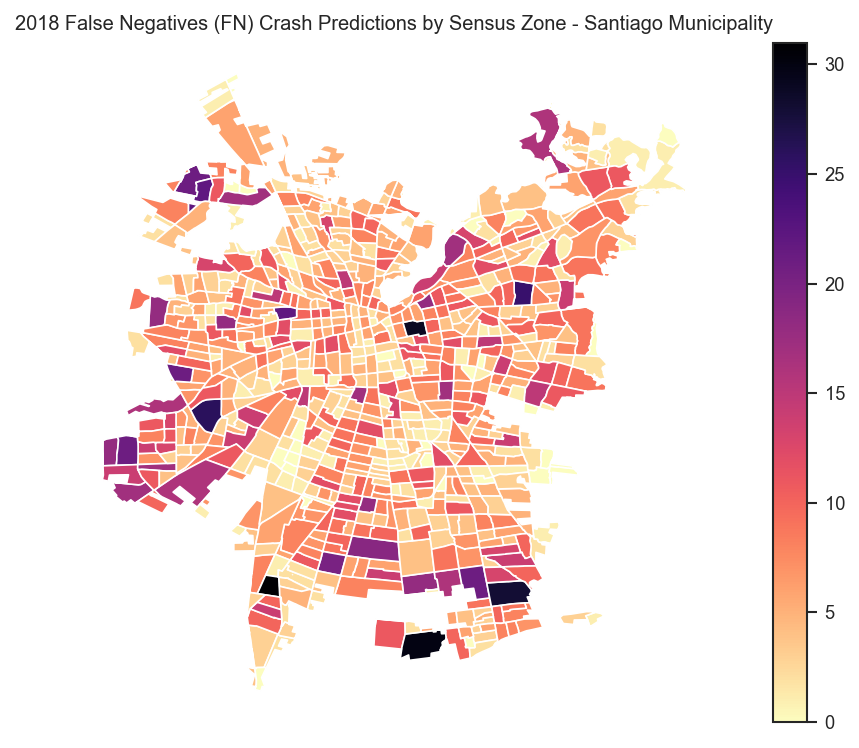

In [106]:
ax = crash_zone_Pred_FN_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 False Negatives (FN) Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

In [109]:
pred_Crashs_2018_TN['Ano'] = 2018
crash_zone_Pred_TN_2018 = adding_din_feat_date_dist_to_grid(context, pred_Crashs_2018_TN, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 49775 events


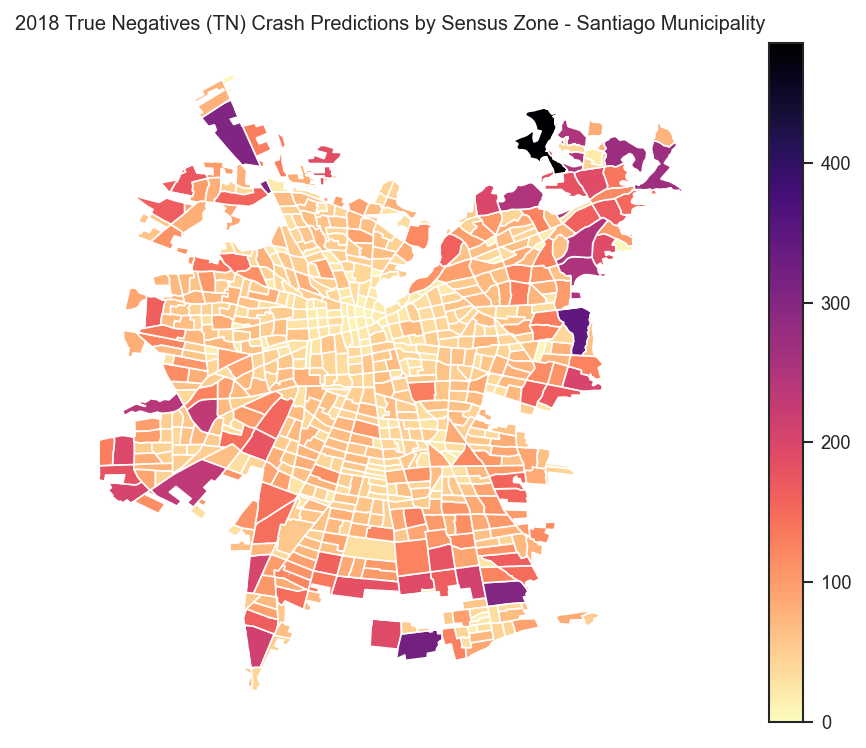

In [110]:
ax = crash_zone_Pred_TN_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 True Negatives (TN) Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

In [111]:
pred_Crashs_2018['Ano'] = 2018
crash_zone_Pred_2018 = adding_din_feat_date_dist_to_grid(context, pred_Crashs_2018, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 4517 events


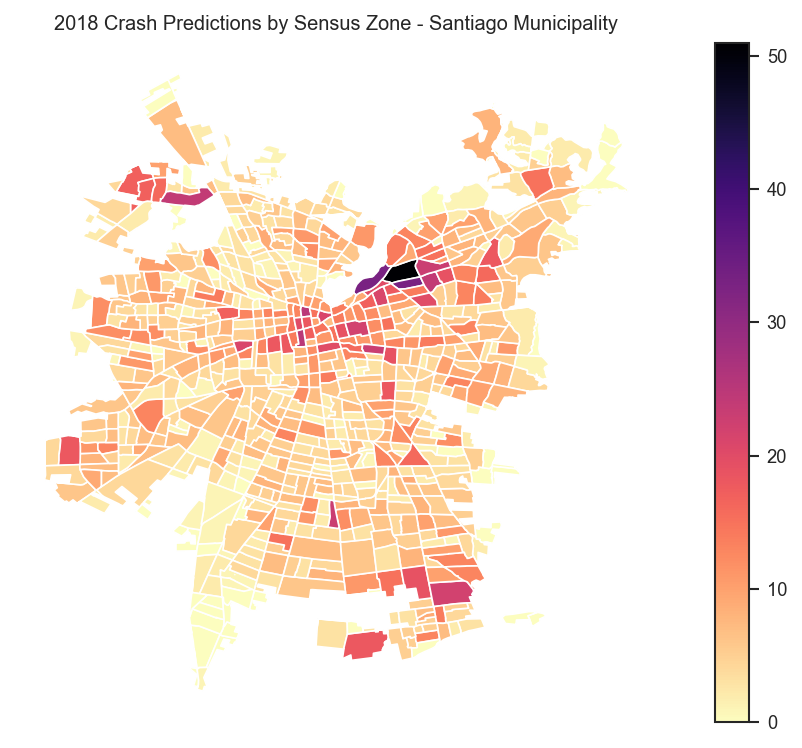

In [112]:
ax = crash_zone_Pred_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

In [113]:
real_Crashs_2018['Ano'] = 2018
crash_zone_real_2018 = adding_din_feat_date_dist_to_grid(context, real_Crashs_2018, 'prediction', 2018, 2018, 1, agg_type='sum', ID = 'Zona')

Grid shape:  (743, 3)
Crash type prediction_1 has 6750 events


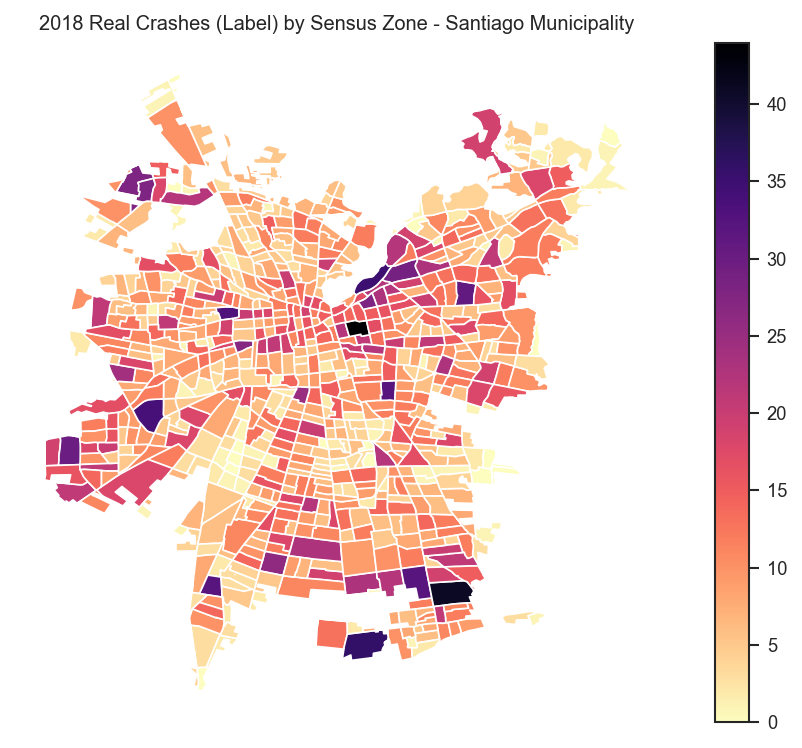

In [114]:
ax = crash_zone_real_2018.plot(column='prediction_1', cmap='magma_r', k=5, legend=True)
plt.title("2018 Real Crashes (Label) by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

In [115]:
roads_path = "../data/OSM_Chile/chile-latest-free/gis_osm_roads_free_1.shp"
roads = gpd.read_file(roads_path, encoding='utf-8', crs={'init': 'epsg:4326'})

In [116]:
roads = gpd.sjoin(roads, stgo_shape, op='intersects')
del roads['index_right']
del roads['NOMBRE']
del roads['TIPO_AREA']
del roads['SHAPE_Leng']
del roads['SHAPE_Area']
roads.crs = {'init' :'epsg:4326'}
roads.head(2)

,osm_id,code,fclass,name,ref,oneway,maxspeed,layer,bridge,tunnel,geometry
0,7981156,5121,unclassified,21 de Mayo,None,B,0,0,F,F,"LINESTRING (-70.6502258 -33.4348941, -70.65025..."
1,7981159,5114,secondary,Irene Morales,None,F,0,0,F,F,"LINESTRING (-70.6369668 -33.4368647, -70.63678..."


In [117]:
roads.fclass.value_counts()

residential       31592
living_street     14810
service           12188
footway           10222
tertiary           3516
secondary          3004
primary            2985
motorway            833
primary_link        773
motorway_link       694
pedestrian          540
steps               358
unclassified        350
secondary_link      324
cycleway            248
tertiary_link       165
path                157
track                93
track_grade2          4
track_grade3          1
bridleway             1
track_grade1          1
Name: fclass, dtype: int64

In [132]:
stgo_primary = roads[roads.fclass == 'primary']
stgo_primary.name.value_counts()

Avenida Américo Vespucio                                 180
Gran Avenida José Miguel Carrera                          87
Avenida Vitacura                                          82
Avenida Francisco Bilbao                                  77
Avenida Apoquindo                                         69
Avenida Departamental                                     68
Avenida Las Condes                                        60
Avenida Irarrázaval                                       59
Avenida Grecia                                            59
Avenida Vicuña Mackenna Oriente                           53
Avenida Libertador Bernardo O'Higgins                     49
Avenida Santa Rosa                                        49
Avenida Cristóbal Colón                                   44
Avenida José Joaquín Prieto Vial                          39
Avenida Macul                                             37
Avenida Independencia                                     36
Avenida Presidente Kenne

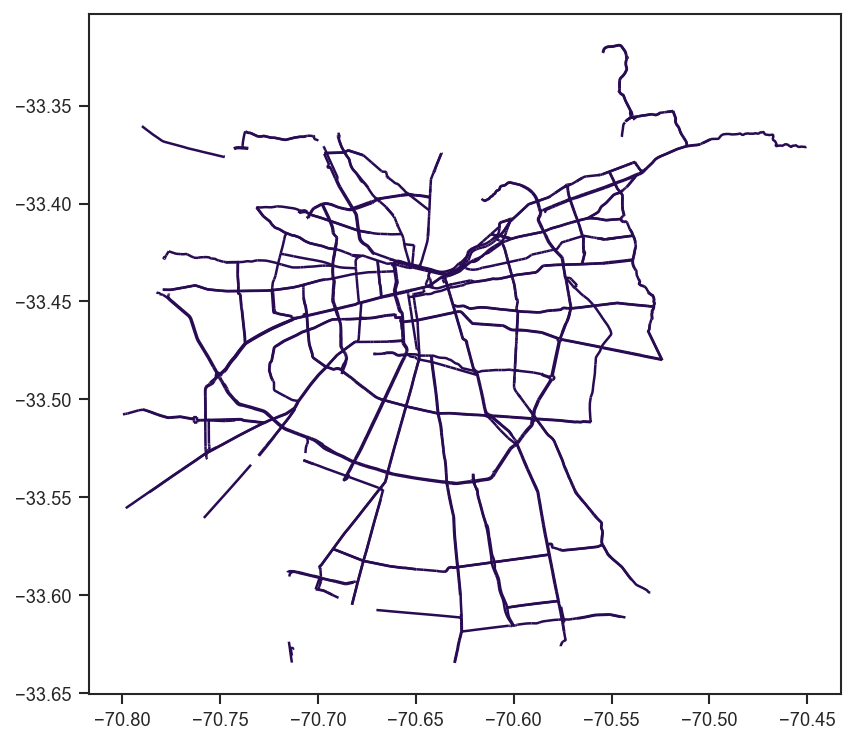

In [133]:
stgo_primary.plot()

In [120]:
stgo_motorways = roads[roads.fclass == 'motorway']

In [121]:
stgo_motorways.name.value_counts()

Autopista Central                            321
Autopista Vespucio Sur                       115
Autopista Costanera Norte                    115
Autopista Vespucio Norte Express              97
Autopista del Aconcagua                       44
Avenida Presidente Kennedy                    42
Autopista del Pacífico                        32
Autopista del Sol                             26
Autopista Acceso Sur                          14
Acceso Túnel San Cristóbal                     5
Autopista Central - Eje General Velásquez      4
Autopista Acceso Sur, Tunel Sur                4
Autopista Acceso Sur, Tunel Norte              4
Autopista Aeropuerto                           3
Túnel Kennedy                                  3
Salida Túnel San Cristóbal                     2
Autopista Los Libertadores                     2
Name: name, dtype: int64

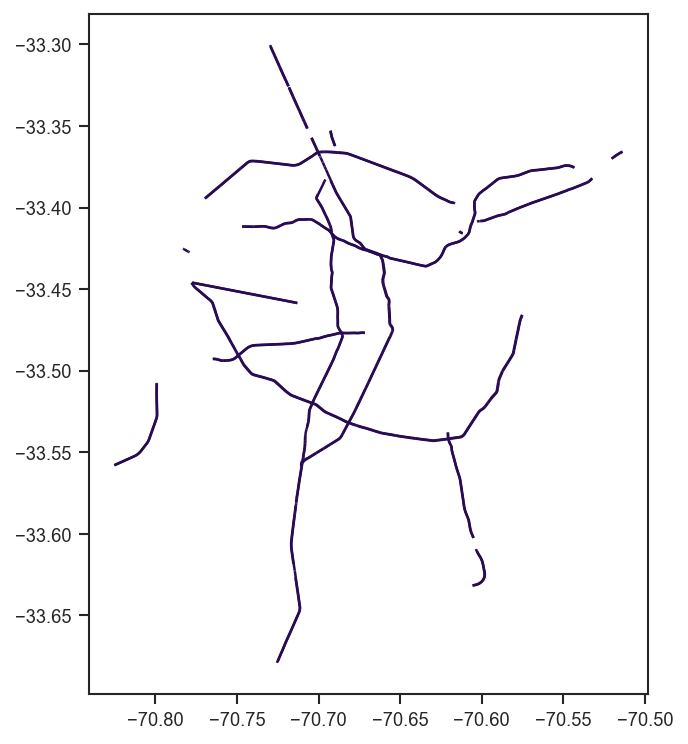

In [122]:
stgo_motorways.plot()

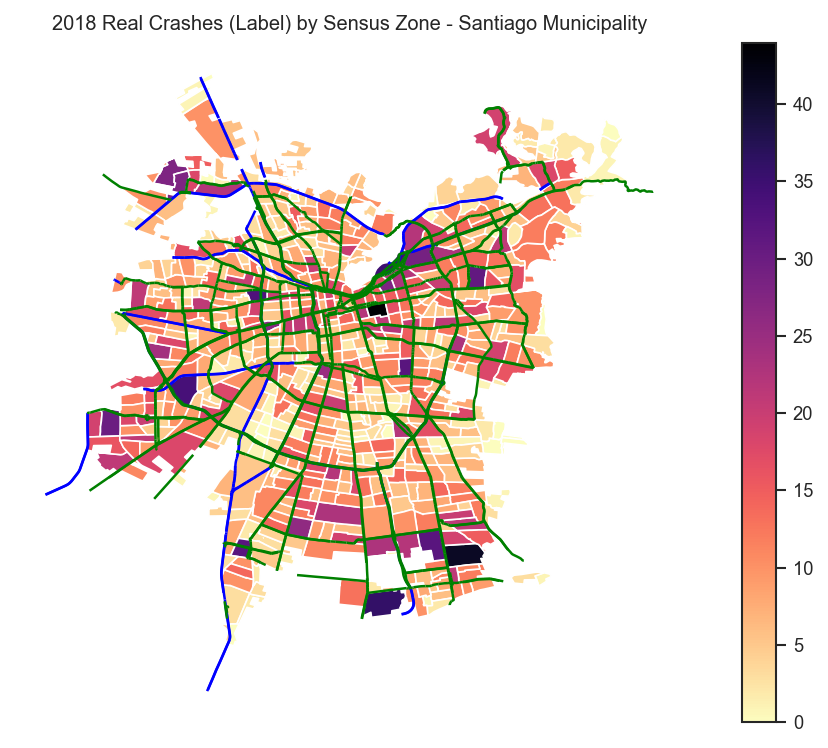

In [134]:
fig, ax = plt.subplots(figsize = (10,6)) 
crash_zone_real_2018.plot(ax=ax, column='prediction_1', cmap='magma_r', k=5, legend=True)
stgo_motorways.plot(ax=ax, color = 'blue')
stgo_primary.plot(ax=ax, color = 'green')
plt.title("2018 Real Crashes (Label) by Sensus Zone - Santiago Municipality");
ax.set_axis_off();

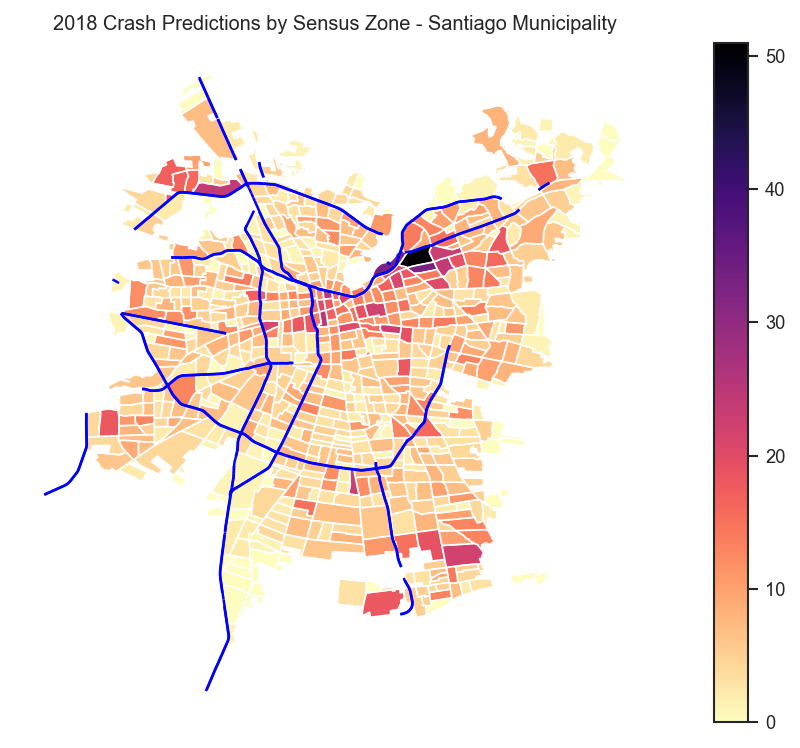

In [131]:
fig, ax = plt.subplots(figsize = (10,6)) 
crash_zone_Pred_2018.plot(ax=ax, column='prediction_1', cmap='magma_r', k=5, legend=True)
stgo_motorways.plot(ax=ax, color = 'blue')
plt.title("2018 Crash Predictions by Sensus Zone - Santiago Municipality");
ax.set_axis_off();